In [40]:
import folium
import pandas as pd
import plotly.express as px
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv(r'data\all_month 1_limpio.csv')

In [8]:
#Mapa de localización geográfica
# Crear el mapa centrado en EE. UU.
mapa = folium.Map(location=[37, -95], zoom_start=4)

# Añadir puntos de terremotos
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=4,
        color='red',
        fill=True,
        fill_opacity=0.6,
        popup=f"Magnitud: {row['mag']}, Lugar: {row['place']}"
    ).add_to(mapa)

mapa.save('mapa_terremotos_localizacion_geografica.html')

In [14]:
mapa

Conclusiones:

Los terremotos están claramente concentrados en zonas sísmicamente activas, como:

California (por la falla de San Andrés), Alaska, y en menor medida Nevada y Oklahoma.

La dispersión también puede mostrar zonas donde antes no se registraban muchos sismos, lo cual puede ser relevante para estudios de riesgo.



<Axes: >

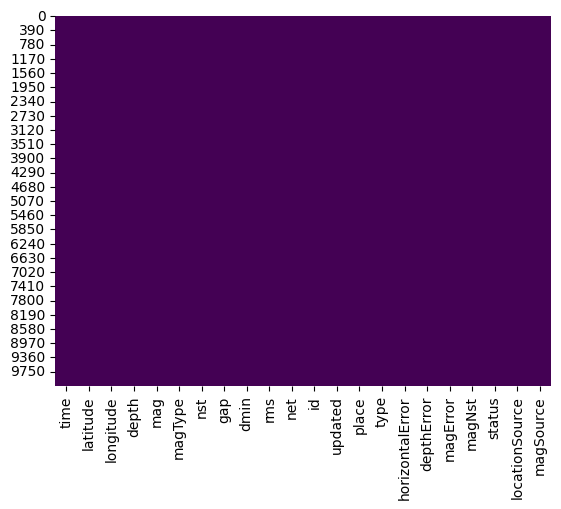

In [16]:
sns.heatmap(df.isnull(), cbar=False, cmap='viridis')

In [17]:
# Mapa de calor de los terremotos
mapa_calor = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=2, control_scale=True)
HeatMap(data=df[['latitude', 'longitude', 'mag']], radius=15, max_zoom=13).add_to(mapa_calor)
mapa_calor.save('mapa_calor_terremotos.html')
mapa_calor

In [ ]:
# Cargar el shapefile de países del mundo
shapefile_path = r'data\ne_110m_admin_0_countries.shp'  # Ajusta la ruta a tu shapefile
gdf_world = gpd.read_file(shapefile_path)

# Filtrar el país de EE.UU.
gdf_us = gdf_world[gdf_world['NAME'] == 'United States of America']

# Asegurarnos de que las coordenadas estén en el formato adecuado
df['latitude'] = pd.to_numeric(df['latitude'], errors='coerce')
df['longitude'] = pd.to_numeric(df['longitude'], errors='coerce')
df = df.dropna(subset=['latitude', 'longitude'])  # Eliminar filas con coordenadas inválidas

# Convertir los datos de los terremotos a un GeoDataFrame
df_gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['longitude'], df['latitude']), crs="EPSG:4326")

# Filtrar los terremotos dentro de las fronteras de EE.UU.
df_us = df_gdf[df_gdf.geometry.within(gdf_us.geometry.iloc[0])]

# Crear el mapa centrado en el promedio de latitud y longitud de los terremotos dentro de EE.UU.
mapa_magnitud = folium.Map(location=[df_us['latitude'].mean(), df_us['longitude'].mean()], zoom_start=5, control_scale=True)

# Función para agregar los marcadores con tamaños y colores basados en la profundidad
for _, row in df_us.iterrows():
    # Seleccionar la profundidad del terremoto
    depth = row['depth']
    
    # Definir el tamaño del marcador basado en la profundidad (puedes ajustar el factor)
    size = min(5 + depth / 10, 50)  # Ajustar el tamaño según la profundidad, máximo 50
    
    # Definir el color del marcador basado en la profundidad
    if depth < 50:
        color = 'green'
    elif depth < 300:
        color = 'orange'
    else:
        color = 'red'
    
    # Crear un marcador para cada terremoto dentro de EE.UU. con la profundidad
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=size,  # Tamaño del marcador
        color=color,  # Color del marcador
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=f"Magnitud: {row['mag']}<br>Profundidad: {depth} km"
    ).add_to(mapa_magnitud)

# Guardar el mapa como un archivo HTML
mapa_magnitud.save('mapa_profundidad_terremotos_usa.html')

# Mostrar el mapa
mapa_magnitud


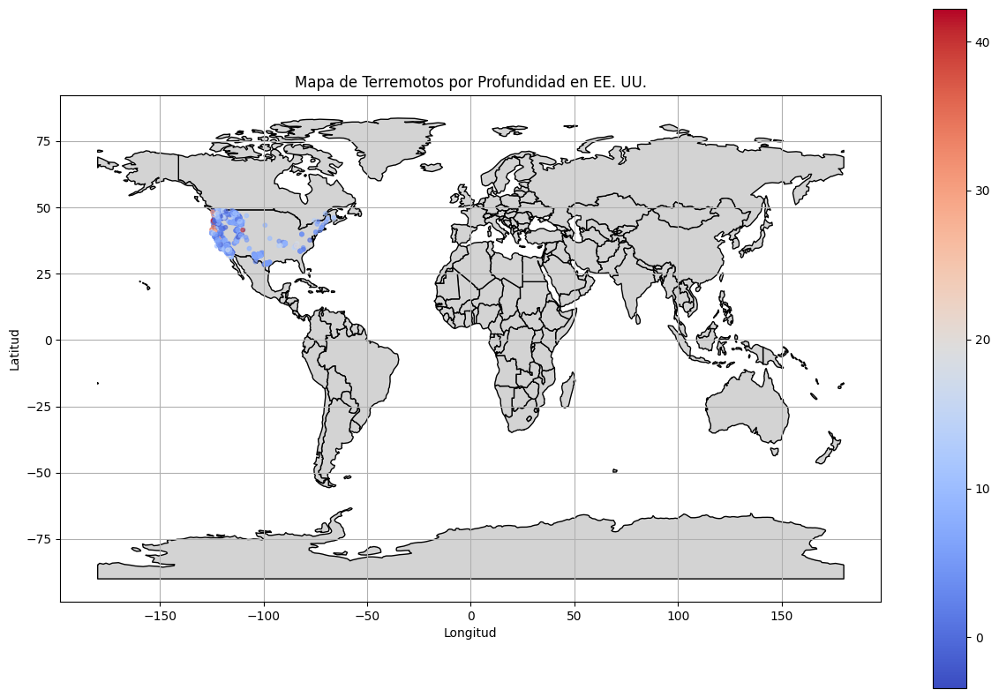

In [46]:


# Crear geometría a partir de latitud y longitud
geometry = [Point(xy) for xy in zip(df['longitude'], df['latitude'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Filtrar terremotos solo en EE. UU.
df_us = gdf[
    (gdf['latitude'] >= 24) & (gdf['latitude'] <= 49) &  # Rango de latitudes para EE. UU.
    (gdf['longitude'] >= -125) & (gdf['longitude'] <= -66)  # Rango de longitudes para EE. UU.
]

# Cargar el shapefile de países para el mapa base
world = gpd.read_file(r"data\ne_110m_admin_0_countries.shp")

# Graficar el mapa de profundidad
fig, ax = plt.subplots(figsize=(15, 10))
world.plot(ax=ax, color='lightgray', edgecolor='black')  # Mapa base

# Graficar los terremotos en EE. UU. con colores según la profundidad
df_us.plot(ax=ax, column='depth', cmap='coolwarm', markersize=10, alpha=0.6, legend=True)

plt.title('Mapa de Terremotos por Profundidad en EE. UU.')
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.grid(True)
plt.show()


In [48]:


# Cargar el shapefile con las fronteras de EE.UU. (puedes descargarlo desde Natural Earth)

us_shapefile = r'data\ne_110m_admin_0_countries.shp'  # Actualiza con la ruta correcta
gdf_us = gpd.read_file(us_shapefile)

# Filtrar solo el polígono de EE.UU.
us_polygon = gdf_us[gdf_us['NAME'] == 'United States of America']


# Aseguramos que las coordenadas estén en el sistema de referencia de coordenadas (CRS) correcto
# Aquí se usa EPSG:4326, que es el CRS estándar para latitudes y longitudes
df_gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['longitude'], df['latitude']), crs="EPSG:4326")

# Filtrar terremotos dentro de los límites de EE.UU.
df_us = df_gdf[df_gdf.geometry.within(us_polygon.geometry.iloc[0])]

# Crear el mapa centrado en el promedio de latitud y longitud de los terremotos dentro de EE.UU.
mapa_errores = folium.Map(location=[df_us['latitude'].mean(), df_us['longitude'].mean()], zoom_start=5, control_scale=True)

# Función para agregar los marcadores con tamaños y colores basados en los errores
for _, row in df_us.iterrows():
    # Seleccionar el error que quieres usar (puedes usar 'horizontalError' o 'magError')
    error = row['horizontalError']  # O también puedes cambiarlo por 'magError'
    
    # Definir el tamaño del marcador basado en el error (puedes ajustar el factor)
    size = min(15 + error, 50)  # Ajustar el tamaño según el valor de error, máximo 50
    
    # Definir el color del marcador basado en el valor de error
    if error < 1:
        color = 'green'
    elif error < 3:
        color = 'orange'
    else:
        color = 'red'
    
    # Crear un marcador para cada terremoto dentro de EE.UU.
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=size,  # Tamaño del marcador
        color=color,  # Color del marcador
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=f"Magnitud: {row['mag']}<br>Profundidad: {row['depth']} km<br>Error en Localización: {error} km"
    ).add_to(mapa_errores)

# Guardar el mapa como un archivo HTML
mapa_errores.save('mapa_errores_terremotos_usa.html')

# Mostrar el mapa (si trabajas en un Jupyter notebook o entorno compatible con Folium)
mapa_errores
